<a href="https://colab.research.google.com/github/keenanpepper/self-ablating-transformers/blob/main/Self_Ablating_Transformer_on_TinyStories.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install datasets
!pip install tiktoken

In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader
import datasets
from datasets import load_dataset
import tiktoken
import os
import numpy as np
from tqdm.notebook import tqdm
import math
import time

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [4]:
class GPTNeoConfig:
    def __init__(self, vocab_size=50257, hidden_size=64, mlp_hidden_size=None, num_layers=8,
                 num_heads=16, max_position_embeddings=2048, window_size=256, attention_layers=None,
                 loss_coeff_base=1.0, loss_coeff_ablated=0.1,
                 loss_coeff_attention_density=0.1, loss_coeff_neuron_density=0.1):
        self.vocab_size = vocab_size
        self.hidden_size = hidden_size  # refers to residual stream width. not number of neurons in MLP, that is 4x more
        if mlp_hidden_size == None:
            self.mlp_hidden_size = 4 * self.hidden_size
        else:
            self.mlp_hidden_size = mlp_hidden_size
        self.num_layers = num_layers    # number of complete transformer blocks
        self.num_heads = num_heads
        self.max_position_embeddings = max_position_embeddings
        self.window_size = window_size  # only used in local attention layers - if all attention is global then this is unused
        if attention_layers == None:
#            self.attention_layers = ["global", "local"] * (num_layers // 2)
            self.attention_layers = ["global"] * num_layers
        else:
            self.attention_layers = attention_layers
        # The following are the 4 coefficients for the 4 different components of the loss function
        # * L_base: cross-entropy loss for unablated first forward pass
        # * L_ablated: cross-entropy loss for ablated second forward pass
        # * L_attention_density: density penalty for attention ablation mask
        # * L_neuron_density: density pentaly for neuron ablation mask
        self.loss_coeff_base = loss_coeff_base
        self.loss_coeff_ablated = loss_coeff_ablated
        self.loss_coeff_attention_density = loss_coeff_attention_density
        self.loss_coeff_neuron_density = loss_coeff_neuron_density

In [5]:
class Attention(nn.Module):
    def __init__(self, config, layer_id):
        super().__init__()
        self.is_local = (config.attention_layers[layer_id] == "local")
        self.num_heads = config.num_heads
        self.hidden_size = config.hidden_size
        self.head_dim = config.hidden_size // config.num_heads

        self.attention = nn.ModuleDict(dict(
            k_proj = nn.Linear(config.hidden_size, config.hidden_size, bias=False),
            v_proj = nn.Linear(config.hidden_size, config.hidden_size, bias=False),
            q_proj = nn.Linear(config.hidden_size, config.hidden_size, bias=False),
            out_proj = nn.Linear(config.hidden_size, config.hidden_size)
        ))

    def forward(self, x_ablated, x_clean, ablation_mask=None):
        """
        Perform multi-head attention with a causal mask and also (optionally) an ablation mask

        x_ablated is the residual stream that's actually undergoing this computation for the first time.

        x_clean (which should have the same shape) is what x was at this same layer on the first, clean,
        forward pass thru the model. It is needed because when one sequence position of x_ablated is
        attending to other sequence positions, it needs to be attending to the clean versions of those
        (since the versions that are there in x_ablated are actually using DIFFERENT ablation masks,
        and they shouldn't get mixed up!).

        x_ablated and x_clean both have shape (batch_size, seq_len, hidden_size)

        ablation_mask is a per-sequence-position ablation mask to apply to the attention outputs.
        For example, let's say the ablation_mask at position 1 is [0,0,0,0,1,1,1,1,1,1,1,1...]
        and the ablation_mask at position 2 is [1,1,1,1,0,0,0,0,1,1,1,1,1...]
        (for this example let's say the head dimension is 4)
        That means the first attention head will be fully ablated at position 1, and the second
        attention head will be fully ablated at position 2.
        But if position 2 is attending back to position 1 then it will see the residual stream values from
        the non-ablated first pass, i.e. from x_clean.

        NOTE for later (TODO?): Currently this code is going to do the easiest, simplest thing, which means
        that for a token attending to *itself*, it still gets the clean version of it, even tho logically
        we might want it to get the ablated version since it's the same sequence position.
        """
        batch_size, seq_len, _ = x_ablated.shape

        assert x_clean.shape == x_ablated.shape
        assert x_clean.device == x_ablated.device

        q = self.attention.q_proj(x_ablated).view(batch_size, seq_len, self.num_heads, self.head_dim).transpose(1, 2)
        k = self.attention.k_proj(x_clean).view(batch_size, seq_len, self.num_heads, self.head_dim).transpose(1, 2)
        v = self.attention.v_proj(x_clean).view(batch_size, seq_len, self.num_heads, self.head_dim).transpose(1, 2)

        # Intentionally don't divide by sqrt(self.num_heads) here, since the reference implementation
        # for which the pretrained weights were trained doesn't have that
        scores = torch.matmul(q, k.transpose(-1, -2))

        if self.is_local:
            # Local attention
            local_mask = torch.ones(seq_len, seq_len, dtype=torch.bool, device=x_clean.device)
            local_mask = torch.triu(local_mask, diagonal=1) | torch.tril(local_mask, diagonal=-config.window_size)
            scores = scores.masked_fill(local_mask.unsqueeze(0).unsqueeze(0), float('-inf'))
        else:
            # Global attention
            causal_mask = torch.triu(torch.ones(seq_len, seq_len, dtype=torch.bool, device=x_clean.device), diagonal=1)
            scores = scores.masked_fill(causal_mask.unsqueeze(0).unsqueeze(0), float('-inf'))

        attn = F.softmax(scores, dim=-1)
        context = torch.matmul(attn, v)

        context = context.transpose(1, 2).contiguous().view(batch_size, seq_len, self.hidden_size)

        # Apply ablation to this "context" value which is the concatenated results of the num_heads heads,
        # right *before* applying out_proj which mixes them all together into the full resisual stream.
        # This is the latest point at which ablation can be applied such that it's possible to, e.g.
        # fully ablate a single head while leaving the rest untouched.
        if ablation_mask is not None:
            nonzero_locs = (torch.abs(ablation_mask) > 1e-5).nonzero().tolist()
            print(f"places where ablation_mask is nonzero: {nonzero_locs}")
            assert context.shape == ablation_mask.shape, f"context has shape {context.shape} while ablation mask has shape {ablation_mask.shape}"
            context = context * ablation_mask

        return self.attention.out_proj(context)

In [6]:
class NewGELUActivation(nn.Module):
    """
    Implementation of the GELU activation function currently in Google BERT repo (identical to OpenAI GPT). Also see
    the Gaussian Error Linear Units paper: https://arxiv.org/abs/1606.08415
    """

    def forward(self, input: torch.Tensor) -> torch.Tensor:
        return 0.5 * input * (1.0 + torch.tanh(math.sqrt(2.0 / math.pi) * (input + 0.044715 * torch.pow(input, 3.0))))

In [7]:
class MLP(nn.Module):
    def __init__(self, config):
        super().__init__()
        self.c_fc = nn.Linear(config.hidden_size, config.mlp_hidden_size)
        self.c_proj = nn.Linear(config.mlp_hidden_size, config.hidden_size)
#        self.act = nn.GELU()
        self.act = NewGELUActivation()

    def forward(self, x, ablation_mask=None):
        """
        Now, here we have a choice of whether to apply the ablation_mask either before or after the activation.
        If we were using ReLU it actually wouldn't matter, because ReLU has the property that
        ReLU(c*x) = c*ReLU(x)
        for all positive reals c.
        But since we're using GeLU here it does matter a bit.
        I'm not sure which makes more sense... for now let's just pick "after the GeLU" and see what happens.

        Note that unlike the Attention layer, this layer does not need access to the clean activations because
        it does not mix information between different sequence positons. The Attention layer is the only
        layer that does that.
        """
        activations = self.act(self.c_fc(x))

        if ablation_mask is not None:
            activations = activations * ablation_mask

        return self.c_proj(activations)

In [8]:
class GPTNeoBlock(nn.Module):
    def __init__(self, config, layer_id):
        super().__init__()
        self.ln_1 = nn.LayerNorm(config.hidden_size, eps=1e-5)
        self.attn = Attention(config, layer_id)
        self.ln_2 = nn.LayerNorm(config.hidden_size, eps=1e-5)
        self.mlp = MLP(config)

    def forward(self, x_ablated, x_clean, attention_ablations=None, neuron_ablations=None):
        x_ablated = x_ablated + self.attn(self.ln_1(x_ablated), self.ln_2(x_clean), attention_ablations)
        x_ablated = x_ablated + self.mlp(self.ln_2(x_ablated), neuron_ablations)
        return x_ablated

In [9]:
class GPTNeo(nn.Module):
    def __init__(self, config):
        super().__init__()
        self.config = config
        self.transformer = nn.ModuleDict(dict(
            wte = nn.Embedding(config.vocab_size, config.hidden_size),
            wpe = nn.Embedding(config.max_position_embeddings, config.hidden_size),
            h = nn.ModuleList([GPTNeoBlock(config, i) for i in range(config.num_layers)]),
            ln_f = nn.LayerNorm(config.hidden_size, eps=1e-5)
        ))
        self.lm_head = nn.Linear(config.hidden_size, config.vocab_size, bias=False)
        self.attention_ablations_head = nn.Linear(config.hidden_size, math.prod(self.get_attention_ablations_shape(1, 1)))
        self.neuron_ablations_head = nn.Linear(config.hidden_size, math.prod(self.get_neuron_ablations_shape(1, 1)))

        # tie weights
        self.transformer.wte.weight = self.lm_head.weight

    def get_attention_ablations_shape(self, batch_size, block_size):
        return torch.Size([batch_size, block_size, self.config.num_layers, self.config.hidden_size])

    def get_neuron_ablations_shape(self, batch_size, block_size):
        return torch.Size([batch_size, block_size, self.config.num_layers, self.config.mlp_hidden_size])

    def forward(self, input_ids, targets=None, attention_ablations=None, neuron_ablations=None):
        """
        If "targets" is supplied, also outputs loss (TODO is this base loss or complete self-ablating loss?)

        input_ids should have shape (batch_size, block_size)

        attention_ablations should have shape (batch_size, block_size, num_layers, hidden_size)

        neuron_ablations should have shape (batch_size, block_size, num_layers, mlp_hidden_size)
        """
        second_pass = attention_ablations != None or neuron_ablations != None

        device = input_ids.device
        b, t = input_ids.shape
        pos = torch.arange(0, t, dtype=torch.long, device=device).unsqueeze(0)

        tok_emb = self.transformer.wte(input_ids)
        pos_emb = self.transformer.wpe(pos)

        x_clean = tok_emb + pos_emb
        if second_pass:
            x_ablated = x_clean

        for i, block in enumerate(self.transformer.h):
            x_clean = block(x_clean, x_clean)
            if second_pass:
                x_ablated = block(x_ablated, x_clean, attention_ablations[:,:,i,:], neuron_ablations[:,:,i,:])

        x = x_ablated if second_pass else x_clean

        x = self.transformer.ln_f(x)
        logits = self.lm_head(x)

        L_base = None
        if targets is not None:
            # Reshape logits to (batch_size * sequence_length, vocab_size)
            logits_view = logits.view(-1, logits.size(-1))
            # Reshape targets to (batch_size * sequence_length,)
            targets_view = targets.view(-1)
            # Compute cross entropy loss
            L_base = F.cross_entropy(logits_view, targets_view)

        if second_pass:
            return {"logits": logits,
                    "L_base": L_base}
        else:
            # if it's the first pass we need to compute these, then do the second pass
            output_attention_ablations = self.attention_ablations_head(x)
            output_attention_ablations = torch.sigmoid(output_attention_ablations)
            output_attention_ablations = output_attention_ablations.reshape(self.get_attention_ablations_shape(b, t))
            output_neuron_ablations = self.neuron_ablations_head(x)
            output_neuron_ablations = torch.sigmoid(output_neuron_ablations)
            output_neuron_ablations = output_neuron_ablations.reshape(self.get_neuron_ablations_shape(b, t))
            second_pass_output = self.forward(input_ids,
                                              targets,
                                              output_attention_ablations,
                                              output_neuron_ablations)
            logits_ablated = second_pass_output["logits"]
            L_total = L_ablated = L_attention_density = L_neuron_density = None
            if targets is not None:
                L_ablated = second_pass_output["L_base"]
                L_attention_density = output_attention_ablations.mean()
                L_neuron_density = output_neuron_ablations.mean()
                L_total = sum([self.config.loss_coeff_base * L_base,
                               self.config.loss_coeff_ablated * L_ablated,
                               self.config.loss_coeff_attention_density * L_attention_density,
                               self.config.loss_coeff_neuron_density * L_neuron_density])
            return {"logits": logits,
                    "logits_ablated": logits_ablated,
                    "L_base": L_base,
                    "L_ablated": L_ablated,
                    "loss": L_total,
                    "attention_ablations": output_attention_ablations,
                    "neuron_ablations": output_neuron_ablations,
                    "attention_ablation_mask_density": L_attention_density,
                    "neuron_ablation_mask_density": L_neuron_density}

    def generate(self, input_ids, max_new_tokens, temperature=1.0, ablated=False):
        """
        Generate completions by sampling from softmax multinomial distribution with a certain temperature applied.
        When ablated==False, it uses the logits from the first, clean forward pass thru the model.
        When ablated==True, it uses the logits from the second forward pass where the ablations generated by the auxiliary head are applied.
        """
        self.eval()
        device = next(self.parameters()).device

        # Ensure input_ids is a tensor on the correct device
        x = torch.tensor(input_ids, dtype=torch.long, device=device).unsqueeze(0) if isinstance(input_ids, list) else input_ids.to(device)

        for _ in range(max_new_tokens):
            # Crop input if it's getting too long
            x_crop = x[:, -self.config.max_position_embeddings:]

            # Forward pass
            ret = self(x_crop)
            logits = ret["logits_ablated"] if ablated else ret["logits"]

            # Focus on the last token's predictions
            logits = logits[:, -1, :] / temperature

            # Apply softmax to convert logits to probabilities
            probs = F.softmax(logits, dim=-1)

            # Sample from the distribution
            next_token = torch.multinomial(probs, num_samples=1)

            # Append the new token to the sequence
            x = torch.cat((x, next_token), dim=1)

        return x[0].tolist()  # Convert to list of token IDs

    def generate_heaviside_ablated(self, input_ids, max_new_tokens, temperature=1.0, attention_threshold=0.5, neuron_threshold=0.5):
        """
        Generate but replacing the ablations generated by the auxiliary head with a Heaviside step function,
        so all ablations < threshold are replaced with 0 and all ablations > threshold are replaced with 1.

        [This actually performs quite bad - the version below that leaves ablations > threshold alone rather than
        replacing them with 1 seems to work a lot better.]
        """
        self.eval()
        device = next(self.parameters()).device

        # Ensure input_ids is a tensor on the correct device
        x = torch.tensor(input_ids, dtype=torch.long, device=device).unsqueeze(0) if isinstance(input_ids, list) else input_ids.to(device)

        att_densities = []
        neu_densities = []

        for _ in range(max_new_tokens):
            # Crop input if it's getting too long
            x_crop = x[:, -self.config.max_position_embeddings:]

            # Forward pass
            ret = self(x_crop)
            attention_ablations, neuron_ablations = ret["attention_ablations"], ret["neuron_ablations"]
            attention_ablations_heaviside = torch.heaviside(attention_ablations - attention_threshold, attention_ablations.new_tensor([0.]))
            neuron_ablations_heaviside = torch.heaviside(neuron_ablations - neuron_threshold, neuron_ablations.new_tensor([0.]))
            ret2 = self(x_crop, attention_ablations=attention_ablations_heaviside, neuron_ablations=neuron_ablations_heaviside)
            att_densities.append(attention_ablations_heaviside.mean().item())
            neu_densities.append(neuron_ablations_heaviside.mean().item())
            logits = ret2["logits"]

            # Focus on the last token's predictions
            logits = logits[:, -1, :] / temperature

            # Apply softmax to convert logits to probabilities
            probs = F.softmax(logits, dim=-1)

            # Sample from the distribution
            next_token = torch.multinomial(probs, num_samples=1)

            # Append the new token to the sequence
            x = torch.cat((x, next_token), dim=1)

        att_mean = torch.tensor(att_densities).mean()
        neu_mean = torch.tensor(neu_densities).mean()
        print(f"attention heaviside density {att_mean}, neuron heaviside density {neu_mean}")

        return x[0].tolist()  # Convert to list of token IDs

    def generate_hard_cutoff_ablated(self, input_ids, max_new_tokens, temperature=1.0, attention_threshold=0.5, neuron_threshold=0.5):
        """
        Generate but replacing all ablations < threshold with 0. Ablations > threshold are left unchanged.
        """
        self.eval()
        device = next(self.parameters()).device

        # Ensure input_ids is a tensor on the correct device
        x = torch.tensor(input_ids, dtype=torch.long, device=device).unsqueeze(0) if isinstance(input_ids, list) else input_ids.to(device)

        att_densities = []
        neu_densities = []
        att_nonzeros = []
        neu_nonzeros = []

        for _ in range(max_new_tokens):
            # Crop input if it's getting too long
            x_crop = x[:, -self.config.max_position_embeddings:]

            # Forward pass
            ret = self(x_crop)
            attention_ablations, neuron_ablations = ret["attention_ablations"], ret["neuron_ablations"]
            attention_ablations_clipped = torch.where(attention_ablations > attention_threshold, attention_ablations, torch.zeros_like(attention_ablations))
            neuron_ablations_clipped = torch.where(neuron_ablations > neuron_threshold, neuron_ablations, torch.zeros_like(neuron_ablations))
            ret2 = self(x_crop, attention_ablations=attention_ablations_clipped, neuron_ablations=neuron_ablations_clipped)
            att_which_clipped = torch.where(attention_ablations > attention_threshold, torch.ones_like(attention_ablations), torch.zeros_like(attention_ablations))
            neu_which_clipped = torch.where(neuron_ablations > neuron_threshold, torch.ones_like(neuron_ablations), torch.zeros_like(neuron_ablations))
            att_densities.append(att_which_clipped[:,-1].mean().item())
            neu_densities.append(neu_which_clipped[:,-1].mean().item())
            att_nonzeros.append(att_which_clipped[:,-1].sum().item())
            neu_nonzeros.append(neu_which_clipped[:,-1].sum().item())
            logits = ret2["logits"]

            # Focus on the last token's predictions
            logits = logits[:, -1, :] / temperature

            # Apply softmax to convert logits to probabilities
            probs = F.softmax(logits, dim=-1)

            # Sample from the distribution
            next_token = torch.multinomial(probs, num_samples=1)

            # Append the new token to the sequence
            x = torch.cat((x, next_token), dim=1)

        att_mean = torch.tensor(att_densities).mean()
        neu_mean = torch.tensor(neu_densities).mean()
        print(f"attention nonzero density {att_mean}, neuron nonzero density {neu_mean}")
        print(f"attention nonzero elements per token {att_nonzeros}, neuron nonzero elements per token {neu_nonzeros}")

        return x[0].tolist()  # Convert to list of token IDs

In [10]:
from transformers import AutoModelForCausalLM, AutoTokenizer, GenerationConfig

ts1m = AutoModelForCausalLM.from_pretrained('roneneldan/TinyStories-1M')

ts3m = AutoModelForCausalLM.from_pretrained('roneneldan/TinyStories-3M')

/home/jazhyc/miniconda3/envs/ablation/lib/python3.11/site-packages/torch/_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()


In [12]:
config = GPTNeoConfig(hidden_size=128)
model = GPTNeo(config)
model.load_state_dict(ts3m.state_dict(), strict=False)

_IncompatibleKeys(missing_keys=['attention_ablations_head.weight', 'attention_ablations_head.bias', 'neuron_ablations_head.weight', 'neuron_ablations_head.bias'], unexpected_keys=[])

In [23]:
# Parameter count comparison
def get_param_count(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f"TinyStories-1M - {get_param_count(ts1m)} parameters")
print(f"TinyStories-3M - {get_param_count(ts3m)} parameters")
print(f"GPTNeo - {get_param_count(model)} parameters")

TinyStories-1M - 3745984 parameters
TinyStories-3M - 8278400 parameters
GPTNeo - 8938880 parameters


From the above parameter count, we see that our model is closer to TinyStories-3M. We still possess a larger parameter count since there are additional weights for the self-ablation mechanism.

In [13]:
# Forward pass without targets
input_ids = torch.randint(0, config.vocab_size, (1, 100))
ret = model(input_ids)
print("Logits shape:", ret["logits"].shape)  # Should be (1, 100, 50257)
print("Loss:", ret["loss"])  # Should be None
print([(key, value.shape if value != None else None) for key, value in ret.items()])

# Forward pass with targets
targets = torch.randint(0, config.vocab_size, (1, 100))
ret = model(input_ids, targets)
print("Logits shape:", ret["logits"].shape)  # Should be (1, 100, 50257)
print("Loss:", ret["loss"])  # Should be a tensor with a single value
print([(key, value.shape if value != None else None) for key, value in ret.items()])

places where ablation_mask is nonzero: [[0, 0, 0], [0, 0, 1], [0, 0, 2], [0, 0, 3], [0, 0, 4], [0, 0, 5], [0, 0, 6], [0, 0, 7], [0, 0, 8], [0, 0, 9], [0, 0, 10], [0, 0, 11], [0, 0, 12], [0, 0, 13], [0, 0, 14], [0, 0, 15], [0, 0, 16], [0, 0, 17], [0, 0, 18], [0, 0, 19], [0, 0, 20], [0, 0, 21], [0, 0, 22], [0, 0, 23], [0, 0, 24], [0, 0, 25], [0, 0, 26], [0, 0, 27], [0, 0, 28], [0, 0, 29], [0, 0, 30], [0, 0, 31], [0, 0, 32], [0, 0, 33], [0, 0, 34], [0, 0, 35], [0, 0, 36], [0, 0, 37], [0, 0, 38], [0, 0, 39], [0, 0, 40], [0, 0, 41], [0, 0, 42], [0, 0, 43], [0, 0, 44], [0, 0, 45], [0, 0, 46], [0, 0, 47], [0, 0, 48], [0, 0, 49], [0, 0, 50], [0, 0, 51], [0, 0, 52], [0, 0, 53], [0, 0, 54], [0, 0, 55], [0, 0, 56], [0, 0, 57], [0, 0, 58], [0, 0, 59], [0, 0, 60], [0, 0, 61], [0, 0, 62], [0, 0, 63], [0, 0, 64], [0, 0, 65], [0, 0, 66], [0, 0, 67], [0, 0, 68], [0, 0, 69], [0, 0, 70], [0, 0, 71], [0, 0, 72], [0, 0, 73], [0, 0, 74], [0, 0, 75], [0, 0, 76], [0, 0, 77], [0, 0, 78], [0, 0, 79], [0, 0, 80]

In [ ]:
ds = datasets.load_dataset("tdooms/TinyStories")

Generating train split:   0%|          | 0/1798254 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/16384 [00:00<?, ? examples/s]

In [ ]:
def prepare_data(dataset_name="tdooms/TinyStories", split="train", separator_token="<|endoftext|>", output_file="train.bin"):
    # Initialize tokenizer
    enc = tiktoken.get_encoding("gpt2")
    separator_token_id = enc.encode_single_token(separator_token)

    def process(example):
        ids = enc.encode_ordinary(example['text'])  # encode_ordinary ignores any special tokens
        ids.append(separator_token_id)  # Add separator token at the end of each example
        return {'ids': ids, 'len': len(ids)}

    # Load and process the dataset
    if not os.path.exists(output_file):
        print(f"Processing {dataset_name} dataset...")
        ds = load_dataset(dataset_name, split=split)

        tokenized = ds.map(
            process,
            remove_columns=['text'],
            desc="Tokenizing the dataset",
            num_proc=8,
        )

        # Concatenate all ids into one large file
        arr_len = np.sum(tokenized['len'], dtype=np.uint64)
        dtype = np.uint16  # Can use uint16 since enc.max_token_value == 50256 is < 2**16
        arr = np.memmap(output_file, dtype=dtype, mode='w+', shape=(arr_len,))

        total_batches = 1024
        idx = 0

        for batch_idx in tqdm(range(total_batches), desc=f'Writing {output_file}'):
            # Batch together samples for faster write
            batch = tokenized.shard(num_shards=total_batches, index=batch_idx, contiguous=True).with_format('numpy')
            arr_batch = np.concatenate(batch['ids'])
            # Write into mmap
            arr[idx : idx + len(arr_batch)] = arr_batch
            idx += len(arr_batch)

        arr.flush()
        print(f"Dataset processed and saved to {output_file}")
    else:
        print(f"{output_file} already exists. Skipping processing.")

    # Load the processed data
    data = np.memmap(output_file, dtype=np.uint16, mode='r')
    return data, enc

In [ ]:
data, tokenizer = prepare_data(separator_token="<|endoftext|>")
print(f"Processed data shape: {data.shape}")
print(f"First 10 tokens: {data[:10]}")
print(f"Last 10 tokens: {data[-10:]}")

# Decode a small portion to verify
sample = data[:10000]
decoded = tokenizer.decode(sample.tolist())
print("\nSample decoded text:")
print(decoded[:5000] + "...")  # Print first 500 characters

Processing tdooms/TinyStories dataset...


Tokenizing the dataset (num_proc=8):   0%|          | 0/1798254 [00:00<?, ? examples/s]

Writing train.bin:   0%|          | 0/1024 [00:00<?, ?it/s]

Dataset processed and saved to train.bin
Processed data shape: (396967656,)
First 10 tokens: [ 8888    11 19919   373   845  6568    13   679   373  1016]
Last 10 tokens: [  262 25103 12023   290  8359   257 12625  8073    13 50256]

Sample decoded text:
Today, Tommy was very excited. He was going flying with his mom and dad to a special place. There was a big green flag waving in the wind when they arrived. Tommy was so happy to see it. 

He hopped out of the car and ran up to the flag. He couldn't believe how big it was! He wanted to reach out and touch it. His mom said he could and Tommy smiled.

He waved his little arms, trying to make the flag move. But the wind was too strong. His dad said, "Let me help you, Tommy." He reached out and grabbed the green flag and waved it back and forth. 

Now it was Tommy's turn! He clapped his hands and laughed as he tried to move the flag. He waved it for a long time until he was too tired to do it anymore. The big green flag was so exciting to 

In [ ]:
prepare_data(split="validation", output_file="validation.bin")

Processing tdooms/TinyStories dataset...


Tokenizing the dataset (num_proc=8):   0%|          | 0/16384 [00:00<?, ? examples/s]

Writing validation.bin:   0%|          | 0/1024 [00:00<?, ?it/s]

Dataset processed and saved to validation.bin


(memmap([ 7454,  2402,   257, ..., 20567,    13, 50256], dtype=uint16),
 <Encoding 'gpt2'>)

In [ ]:
class TrainingConfig:
    train_file = "train.bin"
    val_file = "validation.bin"
    block_size = 256
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    num_batches = 120000
    batch_size = 64
    learning_rate = 4e-3
    weight_decay = 0.0
    max_grad_norm = 1.0
    save_path = "best_model.pt"
    eval_iters = 100
    log_interval = 1000

In [ ]:
class BatchGenerator:
    def __init__(self, data_file, block_size, batch_size, device):
        self.data_file = data_file
        self.block_size = block_size
        self.batch_size = batch_size
        self.device = device
        self.device_type = 'cuda' if 'cuda' in device.type else 'cpu'

    def get_batch(self, shifted=True):
        # We recreate np.memmap every batch to avoid a memory leak, as per
        # https://stackoverflow.com/questions/45132940/numpy-memmap-memory-usage-want-to-iterate-once/61472122#61472122
        data = np.memmap(self.data_file, dtype=np.uint16, mode='r')

        # Generate random starting indices
        ix = torch.randint(len(data) - self.block_size, (self.batch_size,))

        shift = 1 if shifted else 0
        # Create input and target tensors
        x = torch.stack([torch.from_numpy((data[i:i+self.block_size]).astype(np.int64)) for i in ix])
        y = torch.stack([torch.from_numpy((data[i+shift:i+shift+self.block_size]).astype(np.int64)) for i in ix])

        if self.device_type == 'cuda':
            # Pin arrays x,y, which allows us to move them to GPU asynchronously (non_blocking=True)
            x, y = x.pin_memory().to(self.device, non_blocking=True), y.pin_memory().to(self.device, non_blocking=True)
        else:
            x, y = x.to(self.device), y.to(self.device)

        return x, y

In [ ]:
class LossEstimator:
    def __init__(self, model, train_batch_gen, val_batch_gen, eval_iters):
        self.model = model
        self.train_batch_gen = train_batch_gen
        self.val_batch_gen = val_batch_gen
        self.eval_iters = eval_iters

    def estimate_loss(self):
        stat_names = ["loss", "L_base", "L_ablated", "attention_ablation_mask_density", "neuron_ablation_mask_density"]
        out = {}
        for stat in stat_names:
            out[stat] = {}
        self.model.eval()
        with torch.inference_mode():
            for split, batch_gen in [('train', self.train_batch_gen), ('val', self.val_batch_gen)]:
                stats = {}
                for stat in stat_names:
                    stats[stat] = torch.zeros(self.eval_iters)
                for k in tqdm(range(self.eval_iters)):
                    X, Y = batch_gen.get_batch()
                    ret = self.model(X, Y)
                    for stat in stat_names:
                        stats[stat][k] = ret[stat].item()
                for stat in stat_names:
                    out[stat][split] = stats[stat].mean()
        self.model.train()
        return out

    def estimate_loss_pretrainedformat(self):
        out = {}
        self.model.eval()
        with torch.inference_mode():
            for split, batch_gen in [('train', self.train_batch_gen), ('val', self.val_batch_gen)]:
                losses = torch.zeros(self.eval_iters)
                for k in tqdm(range(self.eval_iters)):
                    X, Y = batch_gen.get_batch(shifted=False)
                    ret = self.model(X, labels=Y)
                    losses[k] = ret["loss"].item()
                out[split] = losses.mean()
        self.model.train()
        return out

In [ ]:
def train_gptneo(model, config):
    train_batch_gen = BatchGenerator(config.train_file, config.block_size, config.batch_size, config.device)
    val_batch_gen = BatchGenerator(config.val_file, config.block_size, config.batch_size, config.device)
    loss_estimator = LossEstimator(model, train_batch_gen, val_batch_gen, config.eval_iters)

    model.to(device)

    optimizer = optim.AdamW(model.parameters(), lr=config.learning_rate, weight_decay=config.weight_decay)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=config.num_batches)

    best_val_loss = float('inf')

    for iteration in tqdm(range(config.num_batches)):
        model.train()

        # Get batch
        x, y = train_batch_gen.get_batch()

        # Forward pass
        loss = model(x, targets=y)["loss"]

        # Backward pass
        optimizer.zero_grad()
        loss.backward()

        if config.max_grad_norm:
            nn.utils.clip_grad_norm_(model.parameters(), config.max_grad_norm)

        optimizer.step()
        scheduler.step()

        # Logging
        if (iteration + 1) % config.log_interval == 0:
            stats = loss_estimator.estimate_loss()
            print(f"Iteration {iteration}: train loss {stats['loss']['train']:.4f}, val loss {stats['loss']['val']:.4f}")
            print(f"train L_base {stats['L_base']['train']:.4f}, val L_base {stats['L_base']['val']:.4f}")
            print(f"train L_ablated {stats['L_ablated']['train']:.4f}, val L_ablated {stats['L_ablated']['val']:.4f}")
            print(f"train attention ablation mask density {stats['attention_ablation_mask_density']['train']:.4f}, val {stats['attention_ablation_mask_density']['val']:.4f}")
            print(f"train neuron ablation mask density {stats['neuron_ablation_mask_density']['train']:.4f}, val {stats['neuron_ablation_mask_density']['val']:.4f}")
            print(f"The current learning rate: {optimizer.param_groups[0]['lr']:.4f}")

            # Save best model
            if stats['loss']['val'] < best_val_loss:
                best_val_loss = stats['loss']['val']
                torch.save(model.state_dict(), config.save_path)
                print(f"New best model saved to {config.save_path}")

    print("Training completed!")

In [ ]:
config = GPTNeoConfig(hidden_size=128, loss_coeff_attention_density=0.1, loss_coeff_neuron_density=0.1)
model = GPTNeo(config)

training_config = TrainingConfig()

train_gptneo(model, training_config)

  0%|          | 0/120000 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 999: train loss 4.7165, val loss 4.7265
train L_base 4.2844, val L_base 4.2935
train L_ablated 4.3070, val L_ablated 4.3165
train attention ablation mask density 0.0059, val 0.0059
train neuron ablation mask density 0.0076, val 0.0076
The current learning rate: 0.0040
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 1999: train loss 4.1531, val loss 4.1564
train L_base 3.7705, val L_base 3.7736
train L_ablated 3.8082, val L_ablated 3.8107
train attention ablation mask density 0.0082, val 0.0082
train neuron ablation mask density 0.0094, val 0.0094
The current learning rate: 0.0040
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 2999: train loss 3.8670, val loss 3.8627
train L_base 3.5101, val L_base 3.5061
train L_ablated 3.5517, val L_ablated 3.5481
train attention ablation mask density 0.0071, val 0.0071
train neuron ablation mask density 0.0105, val 0.0105
The current learning rate: 0.0040
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 3999: train loss 3.5785, val loss 3.5909
train L_base 3.2487, val L_base 3.2599
train L_ablated 3.2797, val L_ablated 3.2912
train attention ablation mask density 0.0071, val 0.0071
train neuron ablation mask density 0.0121, val 0.0121
The current learning rate: 0.0040
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 4999: train loss 3.1165, val loss 3.1309
train L_base 2.8277, val L_base 2.8408
train L_ablated 2.8662, val L_ablated 2.8786
train attention ablation mask density 0.0066, val 0.0066
train neuron ablation mask density 0.0154, val 0.0154
The current learning rate: 0.0040
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 5999: train loss 2.8922, val loss 2.8943
train L_base 2.6247, val L_base 2.6267
train L_ablated 2.6527, val L_ablated 2.6538
train attention ablation mask density 0.0048, val 0.0048
train neuron ablation mask density 0.0171, val 0.0171
The current learning rate: 0.0040
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 6999: train loss 2.7548, val loss 2.7590
train L_base 2.5008, val L_base 2.5046
train L_ablated 2.5181, val L_ablated 2.5215
train attention ablation mask density 0.0037, val 0.0037
train neuron ablation mask density 0.0184, val 0.0184
The current learning rate: 0.0040
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 7999: train loss 2.6628, val loss 2.6674
train L_base 2.4177, val L_base 2.4219
train L_ablated 2.4282, val L_ablated 2.4325
train attention ablation mask density 0.0031, val 0.0031
train neuron ablation mask density 0.0193, val 0.0193
The current learning rate: 0.0040
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 8999: train loss 2.5936, val loss 2.6015
train L_base 2.3548, val L_base 2.3620
train L_ablated 2.3657, val L_ablated 2.3725
train attention ablation mask density 0.0026, val 0.0026
train neuron ablation mask density 0.0199, val 0.0198
The current learning rate: 0.0039
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 9999: train loss 2.5366, val loss 2.5545
train L_base 2.3031, val L_base 2.3194
train L_ablated 2.3133, val L_ablated 2.3295
train attention ablation mask density 0.0021, val 0.0021
train neuron ablation mask density 0.0195, val 0.0195
The current learning rate: 0.0039
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 10999: train loss 2.4977, val loss 2.5099
train L_base 2.2685, val L_base 2.2795
train L_ablated 2.2710, val L_ablated 2.2824
train attention ablation mask density 0.0019, val 0.0019
train neuron ablation mask density 0.0199, val 0.0199
The current learning rate: 0.0039
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 11999: train loss 2.4596, val loss 2.4727
train L_base 2.2336, val L_base 2.2456
train L_ablated 2.2389, val L_ablated 2.2507
train attention ablation mask density 0.0015, val 0.0015
train neuron ablation mask density 0.0192, val 0.0193
The current learning rate: 0.0039
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 12999: train loss 2.4315, val loss 2.4303
train L_base 2.2080, val L_base 2.2069
train L_ablated 2.2134, val L_ablated 2.2117
train attention ablation mask density 0.0015, val 0.0015
train neuron ablation mask density 0.0205, val 0.0205
The current learning rate: 0.0039
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 13999: train loss 2.3941, val loss 2.4033
train L_base 2.1743, val L_base 2.1827
train L_ablated 2.1761, val L_ablated 2.1848
train attention ablation mask density 0.0013, val 0.0013
train neuron ablation mask density 0.0202, val 0.0202
The current learning rate: 0.0039
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 14999: train loss 2.3702, val loss 2.3763
train L_base 2.1528, val L_base 2.1583
train L_ablated 2.1530, val L_ablated 2.1587
train attention ablation mask density 0.0013, val 0.0013
train neuron ablation mask density 0.0198, val 0.0198
The current learning rate: 0.0038
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 15999: train loss 2.3487, val loss 2.3617
train L_base 2.1331, val L_base 2.1449
train L_ablated 2.1355, val L_ablated 2.1480
train attention ablation mask density 0.0011, val 0.0011
train neuron ablation mask density 0.0188, val 0.0188
The current learning rate: 0.0038
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 16999: train loss 2.3332, val loss 2.3459
train L_base 2.1191, val L_base 2.1306
train L_ablated 2.1214, val L_ablated 2.1328
train attention ablation mask density 0.0011, val 0.0011
train neuron ablation mask density 0.0192, val 0.0193
The current learning rate: 0.0038
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 17999: train loss 2.3162, val loss 2.3322
train L_base 2.1036, val L_base 2.1181
train L_ablated 2.1063, val L_ablated 2.1209
train attention ablation mask density 0.0010, val 0.0010
train neuron ablation mask density 0.0189, val 0.0190
The current learning rate: 0.0038
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 18999: train loss 2.3038, val loss 2.3082
train L_base 2.0926, val L_base 2.0965
train L_ablated 2.0921, val L_ablated 2.0968
train attention ablation mask density 0.0010, val 0.0010
train neuron ablation mask density 0.0189, val 0.0189
The current learning rate: 0.0038
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 19999: train loss 2.2978, val loss 2.2948
train L_base 2.0872, val L_base 2.0843
train L_ablated 2.0869, val L_ablated 2.0845
train attention ablation mask density 0.0009, val 0.0009
train neuron ablation mask density 0.0189, val 0.0189
The current learning rate: 0.0037
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 20999: train loss 2.2741, val loss 2.2804
train L_base 2.0657, val L_base 2.0713
train L_ablated 2.0637, val L_ablated 2.0704
train attention ablation mask density 0.0009, val 0.0009
train neuron ablation mask density 0.0193, val 0.0193
The current learning rate: 0.0037
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 21999: train loss 2.2647, val loss 2.2692
train L_base 2.0570, val L_base 2.0610
train L_ablated 2.0580, val L_ablated 2.0627
train attention ablation mask density 0.0009, val 0.0009
train neuron ablation mask density 0.0186, val 0.0186
The current learning rate: 0.0037
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 22999: train loss 2.2503, val loss 2.2487
train L_base 2.0441, val L_base 2.0427
train L_ablated 2.0420, val L_ablated 2.0404
train attention ablation mask density 0.0008, val 0.0008
train neuron ablation mask density 0.0185, val 0.0184
The current learning rate: 0.0036
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 23999: train loss 2.2391, val loss 2.2482
train L_base 2.0341, val L_base 2.0423
train L_ablated 2.0302, val L_ablated 2.0389
train attention ablation mask density 0.0008, val 0.0008
train neuron ablation mask density 0.0184, val 0.0184
The current learning rate: 0.0036
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 24999: train loss 2.2329, val loss 2.2339
train L_base 2.0283, val L_base 2.0292
train L_ablated 2.0260, val L_ablated 2.0269
train attention ablation mask density 0.0008, val 0.0008
train neuron ablation mask density 0.0188, val 0.0188
The current learning rate: 0.0036
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 25999: train loss 2.2096, val loss 2.2254
train L_base 2.0071, val L_base 2.0216
train L_ablated 2.0049, val L_ablated 2.0193
train attention ablation mask density 0.0008, val 0.0008
train neuron ablation mask density 0.0186, val 0.0186
The current learning rate: 0.0036
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 26999: train loss 2.2069, val loss 2.2163
train L_base 2.0049, val L_base 2.0135
train L_ablated 2.0003, val L_ablated 2.0088
train attention ablation mask density 0.0008, val 0.0008
train neuron ablation mask density 0.0185, val 0.0185
The current learning rate: 0.0035
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 27999: train loss 2.1969, val loss 2.2102
train L_base 1.9956, val L_base 2.0077
train L_ablated 1.9941, val L_ablated 2.0068
train attention ablation mask density 0.0007, val 0.0007
train neuron ablation mask density 0.0177, val 0.0177
The current learning rate: 0.0035
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 28999: train loss 2.1947, val loss 2.2096
train L_base 1.9938, val L_base 2.0073
train L_ablated 1.9906, val L_ablated 2.0047
train attention ablation mask density 0.0007, val 0.0007
train neuron ablation mask density 0.0178, val 0.0178
The current learning rate: 0.0035
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 29999: train loss 2.1838, val loss 2.1889
train L_base 1.9840, val L_base 1.9885
train L_ablated 1.9799, val L_ablated 1.9857
train attention ablation mask density 0.0007, val 0.0007
train neuron ablation mask density 0.0176, val 0.0176
The current learning rate: 0.0034
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 30999: train loss 2.1758, val loss 2.1844
train L_base 1.9768, val L_base 1.9847
train L_ablated 1.9718, val L_ablated 1.9798
train attention ablation mask density 0.0007, val 0.0007
train neuron ablation mask density 0.0172, val 0.0172
The current learning rate: 0.0034
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 31999: train loss 2.1692, val loss 2.1764
train L_base 1.9706, val L_base 1.9771
train L_ablated 1.9680, val L_ablated 1.9754
train attention ablation mask density 0.0007, val 0.0007
train neuron ablation mask density 0.0171, val 0.0171
The current learning rate: 0.0033
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 32999: train loss 2.1622, val loss 2.1732
train L_base 1.9646, val L_base 1.9746
train L_ablated 1.9581, val L_ablated 1.9685
train attention ablation mask density 0.0007, val 0.0007
train neuron ablation mask density 0.0172, val 0.0172
The current learning rate: 0.0033
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 33999: train loss 2.1532, val loss 2.1667
train L_base 1.9563, val L_base 1.9685
train L_ablated 1.9508, val L_ablated 1.9631
train attention ablation mask density 0.0007, val 0.0007
train neuron ablation mask density 0.0177, val 0.0177
The current learning rate: 0.0033
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 34999: train loss 2.1512, val loss 2.1611
train L_base 1.9546, val L_base 1.9636
train L_ablated 1.9478, val L_ablated 1.9570
train attention ablation mask density 0.0007, val 0.0007
train neuron ablation mask density 0.0174, val 0.0174
The current learning rate: 0.0032
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 35999: train loss 2.1512, val loss 2.1551
train L_base 1.9547, val L_base 1.9582
train L_ablated 1.9468, val L_ablated 1.9502
train attention ablation mask density 0.0007, val 0.0007
train neuron ablation mask density 0.0174, val 0.0174
The current learning rate: 0.0032
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 36999: train loss 2.1376, val loss 2.1465
train L_base 1.9422, val L_base 1.9503
train L_ablated 1.9361, val L_ablated 1.9445
train attention ablation mask density 0.0007, val 0.0007
train neuron ablation mask density 0.0167, val 0.0167
The current learning rate: 0.0031
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 37999: train loss 2.1405, val loss 2.1458
train L_base 1.9450, val L_base 1.9498
train L_ablated 1.9379, val L_ablated 1.9430
train attention ablation mask density 0.0007, val 0.0007
train neuron ablation mask density 0.0166, val 0.0166
The current learning rate: 0.0031
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 38999: train loss 2.1336, val loss 2.1392
train L_base 1.9387, val L_base 1.9437
train L_ablated 1.9318, val L_ablated 1.9373
train attention ablation mask density 0.0007, val 0.0007
train neuron ablation mask density 0.0166, val 0.0166
The current learning rate: 0.0030
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 39999: train loss 2.1271, val loss 2.1296
train L_base 1.9328, val L_base 1.9351
train L_ablated 1.9260, val L_ablated 1.9286
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0165, val 0.0165
The current learning rate: 0.0030
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 40999: train loss 2.1182, val loss 2.1285
train L_base 1.9249, val L_base 1.9343
train L_ablated 1.9161, val L_ablated 1.9254
train attention ablation mask density 0.0007, val 0.0007
train neuron ablation mask density 0.0164, val 0.0164
The current learning rate: 0.0030
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 41999: train loss 2.1141, val loss 2.1223
train L_base 1.9210, val L_base 1.9285
train L_ablated 1.9137, val L_ablated 1.9209
train attention ablation mask density 0.0007, val 0.0007
train neuron ablation mask density 0.0168, val 0.0168
The current learning rate: 0.0029
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 42999: train loss 2.1079, val loss 2.1316
train L_base 1.9155, val L_base 1.9371
train L_ablated 1.9065, val L_ablated 1.9279
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0162, val 0.0162
The current learning rate: 0.0029


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 43999: train loss 2.1134, val loss 2.1142
train L_base 1.9203, val L_base 1.9211
train L_ablated 1.9142, val L_ablated 1.9139
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0161, val 0.0161
The current learning rate: 0.0028
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 44999: train loss 2.1040, val loss 2.1187
train L_base 1.9116, val L_base 1.9251
train L_ablated 1.9065, val L_ablated 1.9199
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0162, val 0.0163
The current learning rate: 0.0028


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 45999: train loss 2.1020, val loss 2.1069
train L_base 1.9102, val L_base 1.9147
train L_ablated 1.9015, val L_ablated 1.9059
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0157, val 0.0157
The current learning rate: 0.0027
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 46999: train loss 2.0969, val loss 2.1021
train L_base 1.9056, val L_base 1.9103
train L_ablated 1.8963, val L_ablated 1.9011
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0159, val 0.0159
The current learning rate: 0.0027
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 47999: train loss 2.0946, val loss 2.1017
train L_base 1.9033, val L_base 1.9097
train L_ablated 1.8969, val L_ablated 1.9035
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0157, val 0.0158
The current learning rate: 0.0026
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 48999: train loss 2.0721, val loss 2.0990
train L_base 1.8832, val L_base 1.9076
train L_ablated 1.8729, val L_ablated 1.8973
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0159, val 0.0159
The current learning rate: 0.0026
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 49999: train loss 2.0848, val loss 2.0938
train L_base 1.8945, val L_base 1.9026
train L_ablated 1.8869, val L_ablated 1.8953
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0157, val 0.0157
The current learning rate: 0.0025
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 50999: train loss 2.0804, val loss 2.0878
train L_base 1.8907, val L_base 1.8974
train L_ablated 1.8813, val L_ablated 1.8885
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0152, val 0.0152
The current learning rate: 0.0025
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 51999: train loss 2.0749, val loss 2.0884
train L_base 1.8856, val L_base 1.8979
train L_ablated 1.8775, val L_ablated 1.8893
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0148, val 0.0148
The current learning rate: 0.0024


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 52999: train loss 2.0792, val loss 2.0896
train L_base 1.8895, val L_base 1.8990
train L_ablated 1.8816, val L_ablated 1.8911
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0146, val 0.0146
The current learning rate: 0.0024


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 53999: train loss 2.0744, val loss 2.0890
train L_base 1.8852, val L_base 1.8985
train L_ablated 1.8754, val L_ablated 1.8891
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0152, val 0.0152
The current learning rate: 0.0023


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 54999: train loss 2.0701, val loss 2.0813
train L_base 1.8814, val L_base 1.8916
train L_ablated 1.8715, val L_ablated 1.8812
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0148, val 0.0148
The current learning rate: 0.0023
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 55999: train loss 2.0646, val loss 2.0729
train L_base 1.8764, val L_base 1.8841
train L_ablated 1.8655, val L_ablated 1.8725
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0152, val 0.0152
The current learning rate: 0.0022
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 56999: train loss 2.0621, val loss 2.0658
train L_base 1.8742, val L_base 1.8775
train L_ablated 1.8640, val L_ablated 1.8676
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0145, val 0.0145
The current learning rate: 0.0022
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 57999: train loss 2.0546, val loss 2.0602
train L_base 1.8674, val L_base 1.8725
train L_ablated 1.8573, val L_ablated 1.8624
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0145, val 0.0145
The current learning rate: 0.0021
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 58999: train loss 2.0615, val loss 2.0645
train L_base 1.8736, val L_base 1.8763
train L_ablated 1.8630, val L_ablated 1.8660
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0149, val 0.0149
The current learning rate: 0.0021


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 59999: train loss 2.0550, val loss 2.0653
train L_base 1.8677, val L_base 1.8771
train L_ablated 1.8572, val L_ablated 1.8664
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0143, val 0.0144
The current learning rate: 0.0020


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 60999: train loss 2.0499, val loss 2.0626
train L_base 1.8632, val L_base 1.8747
train L_ablated 1.8521, val L_ablated 1.8641
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0144, val 0.0144
The current learning rate: 0.0019


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 61999: train loss 2.0530, val loss 2.0530
train L_base 1.8661, val L_base 1.8661
train L_ablated 1.8541, val L_ablated 1.8543
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0144, val 0.0144
The current learning rate: 0.0019
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 62999: train loss 2.0408, val loss 2.0485
train L_base 1.8549, val L_base 1.8619
train L_ablated 1.8442, val L_ablated 1.8514
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0141, val 0.0141
The current learning rate: 0.0018
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 63999: train loss 2.0375, val loss 2.0501
train L_base 1.8520, val L_base 1.8634
train L_ablated 1.8408, val L_ablated 1.8521
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0140, val 0.0140
The current learning rate: 0.0018


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 64999: train loss 2.0365, val loss 2.0521
train L_base 1.8511, val L_base 1.8653
train L_ablated 1.8390, val L_ablated 1.8532
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0140, val 0.0140
The current learning rate: 0.0017


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 65999: train loss 2.0351, val loss 2.0366
train L_base 1.8499, val L_base 1.8513
train L_ablated 1.8375, val L_ablated 1.8387
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0137, val 0.0137
The current learning rate: 0.0017
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 66999: train loss 2.0338, val loss 2.0421
train L_base 1.8488, val L_base 1.8564
train L_ablated 1.8356, val L_ablated 1.8436
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0135, val 0.0136
The current learning rate: 0.0016


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 67999: train loss 2.0272, val loss 2.0456
train L_base 1.8428, val L_base 1.8596
train L_ablated 1.8300, val L_ablated 1.8466
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0134, val 0.0134
The current learning rate: 0.0016


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 68999: train loss 2.0267, val loss 2.0365
train L_base 1.8424, val L_base 1.8512
train L_ablated 1.8298, val L_ablated 1.8389
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0132, val 0.0132
The current learning rate: 0.0015
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 69999: train loss 2.0332, val loss 2.0386
train L_base 1.8484, val L_base 1.8533
train L_ablated 1.8342, val L_ablated 1.8389
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0132, val 0.0133
The current learning rate: 0.0015


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 70999: train loss 2.0248, val loss 2.0384
train L_base 1.8406, val L_base 1.8530
train L_ablated 1.8286, val L_ablated 1.8405
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0130, val 0.0130
The current learning rate: 0.0014


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 71999: train loss 2.0207, val loss 2.0277
train L_base 1.8371, val L_base 1.8434
train L_ablated 1.8226, val L_ablated 1.8290
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0130, val 0.0130
The current learning rate: 0.0014
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 72999: train loss 2.0179, val loss 2.0246
train L_base 1.8345, val L_base 1.8405
train L_ablated 1.8200, val L_ablated 1.8268
train attention ablation mask density 0.0006, val 0.0006
train neuron ablation mask density 0.0132, val 0.0133
The current learning rate: 0.0013
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 73999: train loss 2.0192, val loss 2.0313
train L_base 1.8357, val L_base 1.8467
train L_ablated 1.8218, val L_ablated 1.8329
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0128, val 0.0129
The current learning rate: 0.0013


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 74999: train loss 2.0188, val loss 2.0362
train L_base 1.8353, val L_base 1.8512
train L_ablated 1.8214, val L_ablated 1.8369
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0129, val 0.0129
The current learning rate: 0.0012


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 75999: train loss 2.0075, val loss 2.0238
train L_base 1.8252, val L_base 1.8399
train L_ablated 1.8099, val L_ablated 1.8252
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0128, val 0.0128
The current learning rate: 0.0012
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 76999: train loss 2.0151, val loss 2.0198
train L_base 1.8319, val L_base 1.8363
train L_ablated 1.8181, val L_ablated 1.8218
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0129, val 0.0129
The current learning rate: 0.0011
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 77999: train loss 2.0108, val loss 2.0132
train L_base 1.8282, val L_base 1.8303
train L_ablated 1.8127, val L_ablated 1.8153
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0130, val 0.0129
The current learning rate: 0.0011
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 78999: train loss 2.0074, val loss 2.0214
train L_base 1.8251, val L_base 1.8378
train L_ablated 1.8096, val L_ablated 1.8228
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0127, val 0.0127
The current learning rate: 0.0010


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 79999: train loss 2.0128, val loss 2.0138
train L_base 1.8300, val L_base 1.8309
train L_ablated 1.8150, val L_ablated 1.8157
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0127, val 0.0126
The current learning rate: 0.0010


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 80999: train loss 2.0085, val loss 2.0199
train L_base 1.8261, val L_base 1.8365
train L_ablated 1.8108, val L_ablated 1.8212
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0125, val 0.0125
The current learning rate: 0.0010


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 81999: train loss 2.0023, val loss 2.0081
train L_base 1.8204, val L_base 1.8258
train L_ablated 1.8052, val L_ablated 1.8103
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0127, val 0.0127
The current learning rate: 0.0009
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 82999: train loss 1.9997, val loss 2.0147
train L_base 1.8181, val L_base 1.8318
train L_ablated 1.8027, val L_ablated 1.8161
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0127, val 0.0127
The current learning rate: 0.0009


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 83999: train loss 1.9995, val loss 1.9956
train L_base 1.8180, val L_base 1.8144
train L_ablated 1.8020, val L_ablated 1.7985
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0123, val 0.0123
The current learning rate: 0.0008
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 84999: train loss 1.9960, val loss 2.0059
train L_base 1.8149, val L_base 1.8239
train L_ablated 1.7983, val L_ablated 1.8074
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0123, val 0.0123
The current learning rate: 0.0008


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 85999: train loss 1.9976, val loss 2.0065
train L_base 1.8164, val L_base 1.8244
train L_ablated 1.7999, val L_ablated 1.8085
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0122, val 0.0122
The current learning rate: 0.0007


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 86999: train loss 1.9938, val loss 2.0027
train L_base 1.8130, val L_base 1.8210
train L_ablated 1.7952, val L_ablated 1.8041
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0124, val 0.0124
The current learning rate: 0.0007


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 87999: train loss 1.9947, val loss 2.0035
train L_base 1.8138, val L_base 1.8216
train L_ablated 1.7966, val L_ablated 1.8054
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0124, val 0.0124
The current learning rate: 0.0007


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 88999: train loss 1.9931, val loss 1.9984
train L_base 1.8123, val L_base 1.8171
train L_ablated 1.7954, val L_ablated 1.7998
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0122, val 0.0122
The current learning rate: 0.0006


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 89999: train loss 1.9953, val loss 1.9934
train L_base 1.8143, val L_base 1.8126
train L_ablated 1.7968, val L_ablated 1.7953
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0122, val 0.0122
The current learning rate: 0.0006
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 90999: train loss 1.9952, val loss 1.9990
train L_base 1.8142, val L_base 1.8176
train L_ablated 1.7974, val L_ablated 1.8010
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0121, val 0.0121
The current learning rate: 0.0005


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 91999: train loss 1.9880, val loss 2.0013
train L_base 1.8078, val L_base 1.8198
train L_ablated 1.7897, val L_ablated 1.8023
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0121, val 0.0121
The current learning rate: 0.0005


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 92999: train loss 1.9785, val loss 1.9990
train L_base 1.7992, val L_base 1.8178
train L_ablated 1.7805, val L_ablated 1.7997
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0120, val 0.0120
The current learning rate: 0.0005


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 93999: train loss 1.9859, val loss 1.9932
train L_base 1.8059, val L_base 1.8125
train L_ablated 1.7878, val L_ablated 1.7946
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0117, val 0.0117
The current learning rate: 0.0004
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 94999: train loss 1.9789, val loss 1.9926
train L_base 1.7995, val L_base 1.8120
train L_ablated 1.7810, val L_ablated 1.7939
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0119, val 0.0119
The current learning rate: 0.0004
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 95999: train loss 1.9851, val loss 1.9926
train L_base 1.8052, val L_base 1.8120
train L_ablated 1.7865, val L_ablated 1.7937
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0118, val 0.0118
The current learning rate: 0.0004


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 96999: train loss 1.9830, val loss 1.9915
train L_base 1.8033, val L_base 1.8110
train L_ablated 1.7847, val L_ablated 1.7927
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0119, val 0.0119
The current learning rate: 0.0004
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 97999: train loss 1.9707, val loss 1.9957
train L_base 1.7922, val L_base 1.8148
train L_ablated 1.7728, val L_ablated 1.7956
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0120, val 0.0120
The current learning rate: 0.0003


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 98999: train loss 1.9777, val loss 1.9850
train L_base 1.7986, val L_base 1.8052
train L_ablated 1.7787, val L_ablated 1.7861
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0119, val 0.0119
The current learning rate: 0.0003
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 99999: train loss 1.9845, val loss 1.9812
train L_base 1.8047, val L_base 1.8017
train L_ablated 1.7850, val L_ablated 1.7828
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0117, val 0.0117
The current learning rate: 0.0003
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 100999: train loss 1.9682, val loss 1.9901
train L_base 1.7900, val L_base 1.8099
train L_ablated 1.7698, val L_ablated 1.7896
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0118, val 0.0118
The current learning rate: 0.0002


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 101999: train loss 1.9800, val loss 1.9887
train L_base 1.8007, val L_base 1.8086
train L_ablated 1.7811, val L_ablated 1.7891
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0117, val 0.0118
The current learning rate: 0.0002


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 102999: train loss 1.9707, val loss 1.9821
train L_base 1.7922, val L_base 1.8026
train L_ablated 1.7724, val L_ablated 1.7830
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0117, val 0.0117
The current learning rate: 0.0002


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 103999: train loss 1.9739, val loss 1.9898
train L_base 1.7951, val L_base 1.8097
train L_ablated 1.7753, val L_ablated 1.7896
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0116, val 0.0116
The current learning rate: 0.0002


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 104999: train loss 1.9675, val loss 1.9778
train L_base 1.7894, val L_base 1.7987
train L_ablated 1.7691, val L_ablated 1.7790
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0116, val 0.0116
The current learning rate: 0.0002
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 105999: train loss 1.9646, val loss 1.9829
train L_base 1.7868, val L_base 1.8034
train L_ablated 1.7658, val L_ablated 1.7832
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0116, val 0.0116
The current learning rate: 0.0001


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 106999: train loss 1.9759, val loss 1.9769
train L_base 1.7970, val L_base 1.7980
train L_ablated 1.7768, val L_ablated 1.7776
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0117, val 0.0117
The current learning rate: 0.0001
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 107999: train loss 1.9719, val loss 1.9776
train L_base 1.7934, val L_base 1.7986
train L_ablated 1.7729, val L_ablated 1.7784
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0116, val 0.0116
The current learning rate: 0.0001


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 108999: train loss 1.9712, val loss 1.9866
train L_base 1.7928, val L_base 1.8067
train L_ablated 1.7723, val L_ablated 1.7863
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0116, val 0.0116
The current learning rate: 0.0001


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 109999: train loss 1.9736, val loss 1.9824
train L_base 1.7949, val L_base 1.8029
train L_ablated 1.7742, val L_ablated 1.7825
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0117, val 0.0117
The current learning rate: 0.0001


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 110999: train loss 1.9690, val loss 1.9858
train L_base 1.7908, val L_base 1.8060
train L_ablated 1.7697, val L_ablated 1.7857
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0116, val 0.0116
The current learning rate: 0.0001


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 111999: train loss 1.9670, val loss 1.9821
train L_base 1.7889, val L_base 1.8026
train L_ablated 1.7682, val L_ablated 1.7821
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0116, val 0.0116
The current learning rate: 0.0000


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 112999: train loss 1.9668, val loss 1.9800
train L_base 1.7887, val L_base 1.8008
train L_ablated 1.7681, val L_ablated 1.7801
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0117, val 0.0117
The current learning rate: 0.0000


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 113999: train loss 1.9693, val loss 1.9744
train L_base 1.7911, val L_base 1.7957
train L_ablated 1.7697, val L_ablated 1.7749
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0117, val 0.0117
The current learning rate: 0.0000
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 114999: train loss 1.9751, val loss 1.9788
train L_base 1.7964, val L_base 1.7997
train L_ablated 1.7755, val L_ablated 1.7790
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0116, val 0.0116
The current learning rate: 0.0000


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 115999: train loss 1.9717, val loss 1.9798
train L_base 1.7933, val L_base 1.8006
train L_ablated 1.7716, val L_ablated 1.7795
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0116, val 0.0117
The current learning rate: 0.0000


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 116999: train loss 1.9667, val loss 1.9875
train L_base 1.7887, val L_base 1.8076
train L_ablated 1.7678, val L_ablated 1.7867
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0116, val 0.0117
The current learning rate: 0.0000


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 117999: train loss 1.9760, val loss 1.9711
train L_base 1.7973, val L_base 1.7927
train L_ablated 1.7755, val L_ablated 1.7719
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0116, val 0.0116
The current learning rate: 0.0000
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 118999: train loss 1.9670, val loss 1.9689
train L_base 1.7890, val L_base 1.7907
train L_ablated 1.7676, val L_ablated 1.7699
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0116, val 0.0116
The current learning rate: 0.0000
New best model saved to best_model.pt


  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Iteration 119999: train loss 1.9735, val loss 1.9712
train L_base 1.7949, val L_base 1.7928
train L_ablated 1.7737, val L_ablated 1.7716
train attention ablation mask density 0.0005, val 0.0005
train neuron ablation mask density 0.0116, val 0.0116
The current learning rate: 0.0000
Training completed!


In [ ]:
config = GPTNeoConfig(hidden_size=128)
model = GPTNeo(config)
model.load_state_dict(torch.load("best_model.pt"))
model.to(device)

GPTNeo(
  (transformer): ModuleDict(
    (wte): Embedding(50257, 128)
    (wpe): Embedding(2048, 128)
    (h): ModuleList(
      (0-7): 8 x GPTNeoBlock(
        (ln_1): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
        (attn): Attention(
          (attention): ModuleDict(
            (k_proj): Linear(in_features=128, out_features=128, bias=False)
            (v_proj): Linear(in_features=128, out_features=128, bias=False)
            (q_proj): Linear(in_features=128, out_features=128, bias=False)
            (out_proj): Linear(in_features=128, out_features=128, bias=True)
          )
        )
        (ln_2): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
        (mlp): MLP(
          (c_fc): Linear(in_features=128, out_features=512, bias=True)
          (c_proj): Linear(in_features=512, out_features=128, bias=True)
          (act): NewGELUActivation()
        )
      )
    )
    (ln_f): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
  )
  (lm_head): Linear(in_

In [ ]:
batch = BatchGenerator("train.bin", 256, 32, device).get_batch()

In [ ]:
enc = tiktoken.get_encoding("gpt2")

In [ ]:
enc.decode(batch[0][0, :].tolist())

" had cheerful lights and made loud noises that made him feel better.\n\nAt the hospital, the doctor said Tim needed to take a bath to help his leg feel better. Tim didn't like baths, but he knew it would help him. He got in the bathtub and splashed around, pretending he was a fish. After his bath, Tim felt much better and was able to go home.\n\nFrom that day on, Tim was more careful when he played outside. He didn't want to get hurt and have to take another ambulance ride. But he still enjoyed taking baths and pretending to be a fish. The end.<|endoftext|>Once upon a time there was a loyal dog, who had a long and curly tail. The dog went to sleep one night and when they woke up, they noticed their tail was gone! Someone had stolen it! The loyal dog was so sad and felt very alone.\n\nThe loyal dog decided to go and find the person who had stolen their tail. They looked high and low, but couldn't seem to find the tail. Until, one day they heard a bark and they followed it until they ca

In [ ]:
enc.decode(model.generate(batch[0][13:14, 170:200], max_new_tokens=20, temperature=0.01))

"Once upon a time, there was a boy named Timmy. Timmy had a big red car that he loved to drive. One day, Timmy's mom asked him to help her clean the house. Timmy didn't want to, but"

In [ ]:
enc.decode(model.generate(batch[0][13:14, 170:200], max_new_tokens=20, temperature=0.01, ablated=True))

"Once upon a time, there was a boy named Timmy. Timmy had a big red car that he loved to drive. One day, Timmy's mommy took him to the park to play. Timmy was so excited to play on"

In [ ]:
enc.decode(model.generate_heaviside_ablated(batch[0][13:14, 170:200], max_new_tokens=20, temperature=0.01, attention_threshold=0.02, neuron_threshold=0.02))

attention heaviside density 0.0014874853659421206, neuron heaviside density 0.08350617438554764


'Once upon a time, there was a boy named Timmy. Timmy had a big red car that he loved to drive. One day, Timmy was feeling very bad and could tell himself that street was all blocked by big kids. \n'

In [ ]:
enc.decode(model.generate_hard_cutoff_ablated(batch[0][13:14, 170:200], max_new_tokens=50, temperature=0.01, attention_threshold=0.01, neuron_threshold=0.1))

attention nonzero density 0.0017382812220603228, neuron nonzero density 0.02645019441843033
attention nonzero elements per token [1.0, 1.0, 2.0, 3.0, 3.0, 1.0, 1.0, 3.0, 1.0, 2.0, 1.0, 1.0, 1.0, 2.0, 3.0, 1.0, 3.0, 1.0, 2.0, 3.0, 2.0, 3.0, 4.0, 2.0, 2.0, 1.0, 2.0, 1.0, 2.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 4.0, 2.0, 3.0, 4.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 2.0, 1.0, 2.0, 1.0], neuron nonzero elements per token [83.0, 80.0, 88.0, 112.0, 93.0, 143.0, 90.0, 156.0, 77.0, 91.0, 99.0, 77.0, 148.0, 97.0, 110.0, 114.0, 94.0, 158.0, 87.0, 143.0, 118.0, 102.0, 97.0, 61.0, 210.0, 89.0, 117.0, 142.0, 78.0, 99.0, 68.0, 211.0, 84.0, 113.0, 116.0, 124.0, 111.0, 111.0, 132.0, 60.0, 142.0, 103.0, 157.0, 92.0, 77.0, 97.0, 128.0, 60.0, 94.0, 84.0]


"Once upon a time, there was a boy named Timmy. Timmy had a big red car that he loved to drive. One day, Timmy's friend Billy came over to play. Billy wanted to play with Timmy's car, but Timmy didn't want to share. Billy didn't want to share, so Timmy decided to share his car. Billy was sad, but Tim"

In [ ]:
enc.decode(model.generate_hard_cutoff_ablated(enc.encode("Once upon a time, there was a boy named Timmy. Timmy had a big red car that he loved to drive. One day, Timmy's friend Billy came over to play. Billy wanted to play with"), max_new_tokens=4, temperature=0.01, attention_threshold=0.1, neuron_threshold=0.17))

attention nonzero density 0.0009765625, neuron nonzero density 0.0152587890625
attention nonzero elements per token [1.0, 1.0, 1.0, 1.0], neuron nonzero elements per token [58.0, 69.0, 36.0, 87.0]


"Once upon a time, there was a boy named Timmy. Timmy had a big red car that he loved to drive. One day, Timmy's friend Billy came over to play. Billy wanted to play with Timmy's car"

In [ ]:
enc.decode(model.generate_hard_cutoff_ablated(enc.encode("One day, Lily and Tom were playing in the park. Tom said to"), max_new_tokens=1, temperature=0.01, attention_threshold=0.48, neuron_threshold=0.26))

attention nonzero density 0.0009765625, neuron nonzero density 0.008544921875
attention nonzero elements per token [1.0], neuron nonzero elements per token [35.0]


'One day, Lily and Tom were playing in the park. Tom said to Lily'

In [ ]:
enc.decode(model.generate_hard_cutoff_ablated(enc.encode("One day, Lily and Tom were playing in the park. Lily said to"), max_new_tokens=1, temperature=0.01, attention_threshold=0.48, neuron_threshold=0.26))

attention nonzero density 0.0009765625, neuron nonzero density 0.008544921875
attention nonzero elements per token [1.0], neuron nonzero elements per token [35.0]


'One day, Lily and Tom were playing in the park. Lily said to Tom'

In [ ]:
enc.decode(model.generate_hard_cutoff_ablated(enc.encode("Once upon a time,"), max_new_tokens=50, temperature=0.01, attention_threshold=0.1, neuron_threshold=0.1))

places where ablation_mask is nonzero: [[0, 0, 76], [0, 0, 79], [0, 1, 76], [0, 2, 76], [0, 2, 127], [0, 3, 76], [0, 3, 84], [0, 3, 117], [0, 4, 76]]
places where ablation_mask is nonzero: [[0, 2, 104]]
places where ablation_mask is nonzero: []
places where ablation_mask is nonzero: [[0, 2, 71], [0, 3, 71]]
places where ablation_mask is nonzero: []
places where ablation_mask is nonzero: []
places where ablation_mask is nonzero: [[0, 0, 2], [0, 0, 100], [0, 2, 2], [0, 2, 59], [0, 3, 7], [0, 3, 100], [0, 3, 116], [0, 4, 7], [0, 4, 57]]
places where ablation_mask is nonzero: [[0, 0, 3], [0, 0, 19], [0, 0, 20], [0, 0, 21], [0, 0, 30], [0, 0, 31], [0, 0, 42], [0, 0, 47], [0, 0, 71], [0, 0, 79], [0, 0, 92], [0, 0, 94], [0, 0, 113], [0, 0, 122], [0, 1, 19], [0, 1, 87], [0, 1, 92], [0, 1, 113], [0, 2, 0], [0, 2, 3], [0, 2, 5], [0, 2, 10], [0, 2, 16], [0, 2, 18], [0, 2, 19], [0, 2, 20], [0, 2, 21], [0, 2, 22], [0, 2, 24], [0, 2, 26], [0, 2, 29], [0, 2, 43], [0, 2, 48], [0, 2, 65], [0, 2, 70], [

'Once upon a time, in a small, dark forest, there lived a shy bear named Bob. He loved to play hide and seek. He liked to find new places to hide behind.\n\nOne day, Bob found a big, red apple. He wanted to eat'

In [ ]:
enc.decode(model.generate_hard_cutoff_ablated(enc.encode("Once upon a time,"), max_new_tokens=50, temperature=0.01, attention_threshold=0.9, neuron_threshold=0.1))

attention nonzero density 0.0, neuron nonzero density 0.04060058668255806
attention nonzero elements per token [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], neuron nonzero elements per token [57.0, 69.0, 231.0, 203.0, 74.0, 131.0, 133.0, 235.0, 136.0, 138.0, 137.0, 130.0, 228.0, 120.0, 239.0, 182.0, 247.0, 183.0, 163.0, 162.0, 153.0, 153.0, 154.0, 148.0, 156.0, 153.0, 263.0, 152.0, 146.0, 257.0, 152.0, 259.0, 161.0, 235.0, 148.0, 143.0, 162.0, 259.0, 102.0, 169.0, 153.0, 126.0, 153.0, 161.0, 161.0, 126.0, 284.0, 139.0, 139.0, 150.0]


'Once upon a time,, L Lizzy v v- v v v to Ske that Ske came Ske v v v v v v v v that Ske v that Ske that Ske came Ske v v to Skerum v v that v v v that Ske v v v,'

In [ ]:
ret["attention_ablations"].std()

tensor(0.0146, device='cuda:0', grad_fn=<StdBackward0>)

In [ ]:
import plotly.express as px

px.histogram(ret["attention_ablations"][:30,:30].flatten().detach().cpu(), log_y=True)

In [ ]:
px.histogram(ret["attention_ablations"][:10,:10].flatten().detach().cpu(), log_y=True)

In [ ]:
px.imshow(ret["neuron_ablations"][6,0,:,:64].detach().cpu())

In [ ]:
px.imshow(ret["neuron_ablations"][1,10,:,:64].detach().cpu())

In [ ]:
ts1m.to(device)
LossEstimator(ts1m, BatchGenerator("train.bin", 256, 32, device), BatchGenerator("validation.bin", 256, 32, device), 100).estimate_loss_pretrainedformat()

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

{'train': tensor(2.3472), 'val': tensor(2.3606)}

In [ ]:
enc = tiktoken.get_encoding("gpt2")

In [ ]:
enc.decode(model.generate(enc.encode("Sam was a tall boy. He had lots of toys at home. One day, he wanted to go outside to play. So he asked his mom to take him to the beach.\n\nOnce they arrived, he was so excited. He wanted to explore. He saw an oyster lying on the sand. He didn't know what it was and wanted to play with it. He picked it up and threw it in the air.\n\nHe thought it was fun to watch it sail up and down in the air. He picked up another oyster, and then another one. He was having lots of fun throwing them around.\n\nHis mom then called him over and said it was time to"), 100, temperature=0.01))

"Sam was a tall boy. He had lots of toys at home. One day, he wanted to go outside to play. So he asked his mom to take him to the beach.\n\nOnce they arrived, he was so excited. He wanted to explore. He saw an oyster lying on the sand. He didn't know what it was and wanted to play with it. He picked it up and threw it in the air.\n\nHe thought it was fun to watch it sail up and down in the air. He picked up another oyster, and then another one. He was having lots of fun throwing them around.\n\nHis mom then called him over and said it was time to go home. He said goodbye to the oyster and went home. He was so happy to have his special oyster back.<|endoftext|>Once upon a time, there was a little girl named Lily. She loved to play outside in the sunshine. One day, she saw a big, scary monster in the woods. She was scared and didn't know what to do.\n\nSuddenly, a kind man came and asked her what was wrong. Lily told him about the monster and how she was scared"

In [ ]:
enc.decode(model.generate(torch.tensor(enc.encode(", his parents had to go to work"), dtype=torch.long, device=device).unsqueeze(0), max_new_tokens=50))

", his parents had to go to work together to take care of Jack. Jack didn't understand why. He was a bit impatient and kept going along until they had enough money to buy him something that was cheap. \n\nJenny's parents explained the difference to everyone. Keep him"

In [ ]:
enc.decode(batch[0][0].tolist())

', his parents had to go to work, so Aunt Jenny offered to take Jake for a ride in her Taxi.\n\nJake loved the Taxi ride. He looked out the window and laughed as they drove. Aunt Jenny couldn\'t help smiling at his enthusiasm.\n\nBut soon they got stuck in traffic and had to wait. Jake started to fidget and he started to suffer.\n\nAunt Jenny tried to cheer him up. She said, "Don\'t suffer, Jake. The Taxi will take us soon."\n\nBut Jake stayed silent.\n\nThen, out of nowhere, a small truck pulled up to the Taxi and Uncle Sam got out. He said, "Get in, Jake. I\'ll give you a ride home."\n\nJake was overjoyed and quickly scrambled in to Uncle Sam\'s truck. He waved goodbye to Aunt Jenny as he drove away.\n\nJake was so happy. He learned a lesson that day. Don\'t suffer when you can take a Taxi or a small truck.<|endoftext|>Tim and Kim were twins who liked to play in the kitchen. They had a lot of pots and pans and spoons and cups. They liked to pretend they were chefs and make food for t

In [ ]:
enc.decode(model.generate(enc.encode("Once upon a time"), 100, temperature=0.1))

"Once upon a time, there was a little girl named Lily. She loved to play outside in the sunshine. One day, she saw a big, scary monster in the woods. She was scared and didn't know what to do.\n\nSuddenly, she saw a big, scary monster. It was very scary and scary. Lily was scared and didn't know what to do. She ran back to her house and told her mom about the scary monster. Her mom was very kind and told her not to be scared"

In [ ]:
model.transformer.wpe.weight[:256]

torch.Size([2048, 128])

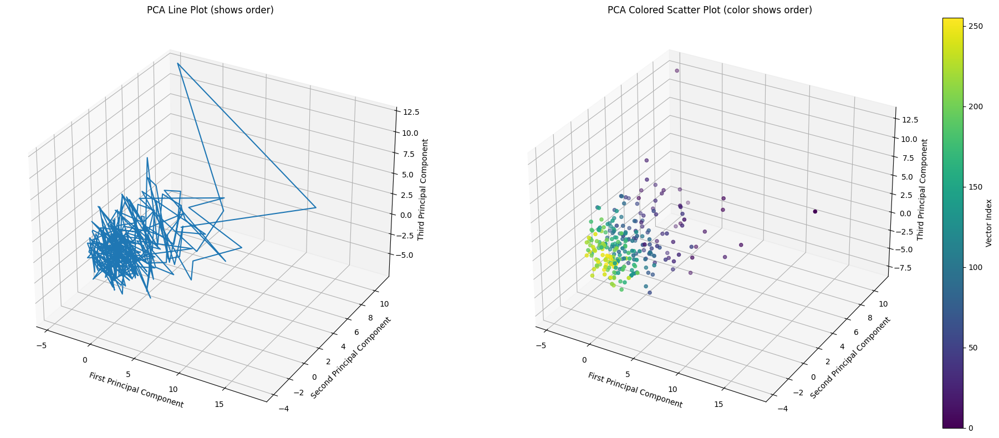

In [ ]:
import torch
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Assume your tensor is named 'data' with shape [2048, 128]
# If you haven't created it yet, you can do so like this:
# data = torch.randn(2048, 128)

# Convert PyTorch tensor to numpy array
data_np = model.transformer.wpe.weight[:256].detach().cpu()

# Perform PCA
pca = PCA(n_components=3)
pca_result = pca.fit_transform(data_np)

# Create a figure with two subplots
fig = plt.figure(figsize=(20, 8))

# 1. Line plot
ax1 = fig.add_subplot(121, projection='3d')
ax1.plot(pca_result[:, 0], pca_result[:, 1], pca_result[:, 2])
ax1.set_xlabel('First Principal Component')
ax1.set_ylabel('Second Principal Component')
ax1.set_zlabel('Third Principal Component')
ax1.set_title('PCA Line Plot (shows order)')

# 2. Colored scatter plot
ax2 = fig.add_subplot(122, projection='3d')
scatter = ax2.scatter(pca_result[:, 0], pca_result[:, 1], pca_result[:, 2],
                      c=range(len(pca_result)), cmap='viridis')
ax2.set_xlabel('First Principal Component')
ax2.set_ylabel('Second Principal Component')
ax2.set_zlabel('Third Principal Component')
ax2.set_title('PCA Colored Scatter Plot (color shows order)')

# Add a colorbar to show the mapping of colors to indices
cbar = plt.colorbar(scatter)
cbar.set_label('Vector Index')

plt.tight_layout()
plt.show()

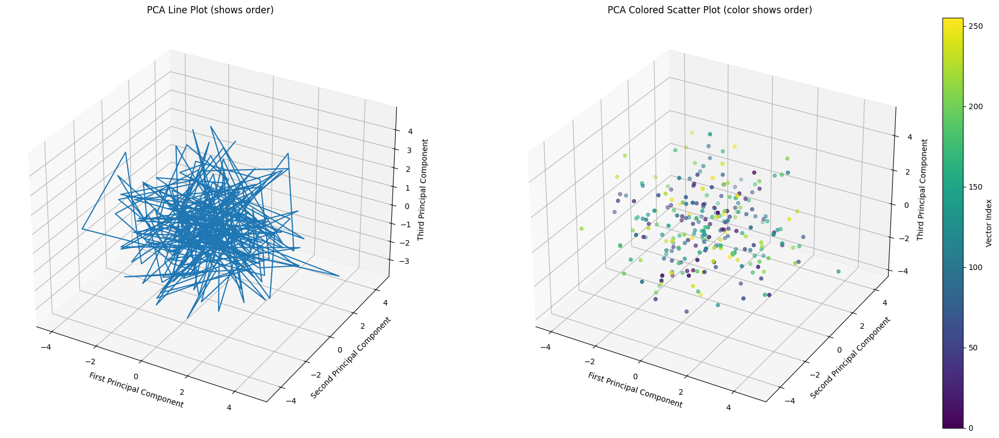

In [ ]:
import torch
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Assume your tensor is named 'data' with shape [2048, 128]
# If you haven't created it yet, you can do so like this:
# data = torch.randn(2048, 128)

# Convert PyTorch tensor to numpy array
data_np = model.transformer.wpe.weight[256:512].detach().cpu()

# Perform PCA
pca = PCA(n_components=3)
pca_result = pca.fit_transform(data_np)

# Create a figure with two subplots
fig = plt.figure(figsize=(20, 8))

# 1. Line plot
ax1 = fig.add_subplot(121, projection='3d')
ax1.plot(pca_result[:, 0], pca_result[:, 1], pca_result[:, 2])
ax1.set_xlabel('First Principal Component')
ax1.set_ylabel('Second Principal Component')
ax1.set_zlabel('Third Principal Component')
ax1.set_title('PCA Line Plot (shows order)')

# 2. Colored scatter plot
ax2 = fig.add_subplot(122, projection='3d')
scatter = ax2.scatter(pca_result[:, 0], pca_result[:, 1], pca_result[:, 2],
                      c=range(len(pca_result)), cmap='viridis')
ax2.set_xlabel('First Principal Component')
ax2.set_ylabel('Second Principal Component')
ax2.set_zlabel('Third Principal Component')
ax2.set_title('PCA Colored Scatter Plot (color shows order)')

# Add a colorbar to show the mapping of colors to indices
cbar = plt.colorbar(scatter)
cbar.set_label('Vector Index')

plt.tight_layout()
plt.show()